In [2]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import math
import mediapipe as mp
import pandas as pd
import time

# Images
## Initial Pose Detection

Here is the original image. It read in as a BGR image, and was converted to RGB for display.

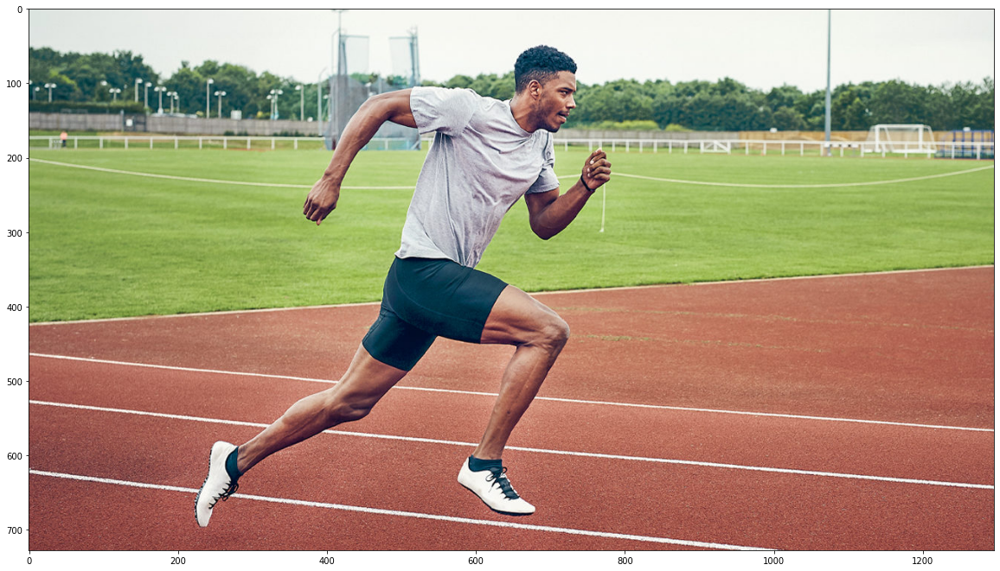

In [3]:
image = cv.imread('./inputs/run_0.jpg')
image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
fig = plt.figure(figsize=(20,20))
plt.imshow(image)

After using the MediaPipe library, poses were detected, and landmarks as well as connections between landmarks were drawn on the image.

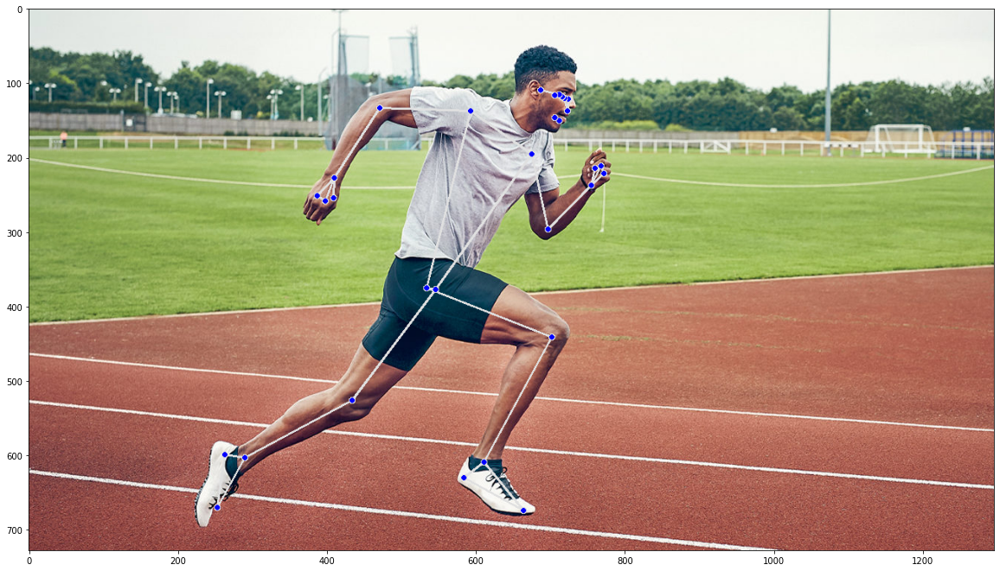

In [4]:
pose_sol = mp.solutions.pose
mp_draw = mp.solutions.drawing_utils
pose = pose_sol.Pose()

results = pose.process(image)
drawn_image = image.copy()
mp_draw.draw_landmarks(drawn_image, results.pose_landmarks, pose_sol.POSE_CONNECTIONS)
fig = plt.figure(figsize=(20,20))
plt.imshow(drawn_image)

## Labelling

For ease of understanding, each landmark could generally be thought of referring to different joints of the body, such as the elbow, or shoulder. In order to access a specific landmark in the original library, we had to use numbers, ranging from 0 to 33, defined at <br> <br>
<img src="https://mediapipe.dev/images/mobile/pose_tracking_full_body_landmarks.png"/> <br>

Hence, instead of using the numbers, we will use the names of the landmarks as labels for ease of use. I will also store the landmarks' image coordinates, as well as world coordinates

In [5]:
# converts to image coordinates
landmark_names = ["nose", "left_eye_inner", "left_eye", "left_eye_outer", "right_eye_inner", "right_eye", "right_eye_outer", "left_ear", "right_ear", "mouth_left", "mouth_right", "left_shoulder", "right_shoulder", "left_elbow", "right_elbow", "left_wrist", "right_wrist", "left_pinky", "right_pinky", "left_index", "right_index", "left_thumb", "right_thumb", "left_hip", "right_hip", "left_knee", "right_knee", "left_ankle", "right_ankle", "left_heel", "right_heel", "left_foot_index", "right_foot_index"]

def label_landmarks():
    landmarks = {}
    for index, name in enumerate(landmark_names):
        landmarks[name] = {'id' : index}

    for id, landmark in enumerate(results.pose_landmarks.landmark):
        height, width, channel = image.shape
        cx, cy = int(landmark.x * width), int(landmark.y * height)
        landmarks[landmark_names[id]]["image_coords"] = (cx, cy)

    for id, landmark in enumerate(results.pose_world_landmarks.landmark):
        x, y, z = landmark.x, landmark.y, landmark.z
        landmarks[landmark_names[id]]["world_coords"] = (x, y, z)

    landmarks_df = pd.DataFrame(landmarks).T
    return landmarks_df

landmarks_df = label_landmarks()
landmarks_df.head()

,id,image_coords,world_coords
nose,0,"(723, 137)","(0.39167237281799316, -0.444375216960907, -0.0..."
left_eye_inner,1,"(725, 122)","(0.3937892019748688, -0.49007827043533325, -0...."
left_eye,2,"(725, 121)","(0.3941047489643097, -0.49005553126335144, -0...."
left_eye_outer,3,"(724, 121)","(0.3941686749458313, -0.4910150170326233, -0.0..."
right_eye_inner,4,"(719, 120)","(0.37828564643859863, -0.4921993315219879, -0...."


Next, we have each vertex, but we do not have each edge and an easy way to access them. The original library already do display the connections, by using the `connections` attribute of the `PoseLandmark` class, but it is not very intuitive. Hence, I will create a dictionary that maps each landmark to its edges. I also named some of the more commonly used edges. For example, the `right_arm` is located between the `right_shoulder` and `right_wrist` landmarks

In less computational science terms, where landmarks are the joints, the following can be think of as the bones, or structure of the body

In [6]:
limb_names = {(12,14):"right_arm", (14,16):"right_forearm", (11,13):"left_arm", (13,15):"left_forearm", (23,25):"left_leg", (25,27):"left_calf", (24,26):"right_leg", 
              (26,28):"right_calf", (29,31): "left_sole", (30,32): "right_sole", (28,32): "right_forefoot", (27,31): "left_forefoot", (11,23): "left_torso", (12,24): "right_torso",
              (11,12): "shoulders", (23,24): "hips"}

def create_limbs():
    limbs = {}
    for tuple in pose_sol.POSE_CONNECTIONS:
        if tuple in limb_names.keys():
            first_node = tuple[0]
            second_node = tuple[1]
            first_node = landmarks_df.loc[landmarks_df['id'] == first_node].iloc[0]
            second_node = landmarks_df.loc[landmarks_df['id'] == second_node].iloc[0]
            name = limb_names[tuple]
            # vector
            vector = np.array(second_node["image_coords"]) - np.array(first_node["image_coords"])
            limbs[name] = {"vector": vector, "first_node": first_node, "second_node": second_node}
    return limbs
limbs = create_limbs()

Now that we have an easy way to refer to each limb we want, such as the `right_arm`, we can access it directly by using the names I defined earlier, which include information of the coordinates of the two joints the limb lies between, such as `right_shoulder` and `right_wrist`. The following shows all the information relevant to the `right_arm` limb

In [7]:
limbs["right_arm"]

{'vector': array([-122,   -4]),
 'first_node': id                                                             12
 image_coords                                           (593, 137)
 world_coords    (0.10789766907691956, -0.4762709140777588, -0....
 Name: right_shoulder, dtype: object,
 'second_node': id                                                             14
 image_coords                                           (471, 133)
 world_coords    (-0.1466064453125, -0.41556280851364136, -0.18...
 Name: right_elbow, dtype: object}

Here are the helper methods to get data we need, such as angle. Previously, with only the joints, it can be difficult to visualize and understand what angle to calculate. Now, with the limbs, it is easier to contextualize what is the data we want. For example, I can simply ask for the angle between `right_arm` and `right_forearm`, and the method will return the angle between the two limbs, the angle at the elbow. 

In [8]:
def get_gradient(point_0, point_1):
    # y1 - y0 / x1 - x0
    return (point_1[1] - point_0[1]) / (point_1[0] - point_0[0])

def get_angle(limb_0, limb_1):
    if limb_0 in limbs.keys() and limb_1 in limbs.keys():
        limb_0_0 = limbs[limb_0]["first_node"]["image_coords"]
        limb_0_1 = limbs[limb_0]["second_node"]["image_coords"]
        limb_1_0 = limbs[limb_1]["first_node"]["image_coords"]
        limb_1_1 = limbs[limb_1]["second_node"]["image_coords"]

        if limb_0_0 == limb_1_0:
            a = limb_0_1
            b = limb_1_1
            common = limb_0_0
        elif limb_0_0 == limb_1_1:
            a = limb_0_1
            b = limb_1_0
            common = limb_0_0
        elif limb_0_1 == limb_1_0:
            a = limb_0_0
            b = limb_1_1
            common = limb_0_1
        elif limb_0_1 == limb_1_1:
            a = limb_0_0
            b = limb_1_0
            common = limb_0_1
        else:
            return None

        m0 = get_gradient(a, common)
        m1 = get_gradient(b, common)
        angle_rad = math.atan((m1 - m0) / (1 + m0 * m1))
        angle_deg = (math.degrees(angle_rad))
        angle_deg = angle_deg if angle_deg > 0 else 180 + angle_deg

        return angle_deg
    else:
        return None

Because there are 2 angles, the acute and obtuse, the function will return one or the other based on the order I entered

In [9]:
ang_0 = get_angle("right_arm", "right_forearm")
ang_1 = get_angle("right_forearm", "right_arm")
print(ang_0, ang_1, ang_0 == ang_1)

121.10312009817011 58.896879901829884 False


## Displaying

The following two functions do the same thing as the built in methods that draw the landmarks and connections

In [10]:
def draw_limbs(image, limbs, thickness=2, colour=(0,255,0)):
    for limb in limbs:
        first_node = limbs[limb]["first_node"]["image_coords"]
        second_node = limbs[limb]["second_node"]["image_coords"]
        cv.line(image, first_node, second_node, colour, thickness)
    return image

def draw_landmarks(image, landmark_db, radius=3, colour=(0, 0, 255)):
    for row in landmark_db.iterrows():
        landmark = row[1]
        cv.circle(image, landmark["image_coords"], radius, colour, -1)

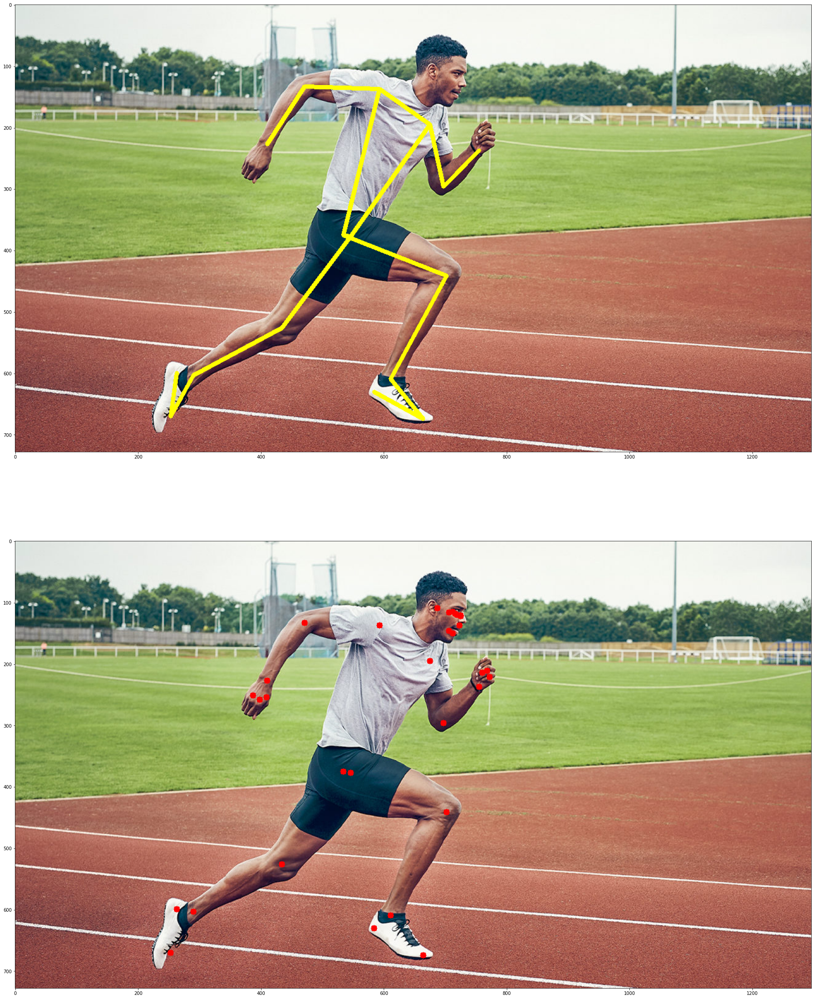

In [11]:
limbs_image = image.copy()
draw_limbs(limbs_image, limbs, 5, colour=(255,255,0))
lands_image = image.copy()
draw_landmarks(lands_image, landmarks_df, 5, colour=(255,0,0))
fig = plt.figure(figsize=(40, 40))
plt.subplot(2, 1, 1)
plt.imshow(limbs_image)
plt.subplot(2, 1, 2)
plt.imshow(lands_image)


The following are the methods to label the image. The first writes the names of each limb, and the second the angles.
I gave the second function a preset `valid_angles` which will bypass the 2 angles problem.

In [12]:
def label_limbs(image, colour=(0,0,0)):
    for limb in limbs.keys():
        first_node = limbs[limb]["first_node"]
        second_node = limbs[limb]["second_node"]
        x = (first_node["image_coords"][0] + second_node["image_coords"][0]) / 2
        y = (first_node["image_coords"][1] + second_node["image_coords"][1]) / 2
        cv.putText(image, limb, (int(x) - 20, int(y) - 20), cv.FONT_HERSHEY_SIMPLEX, 0.5, colour, 1, cv.LINE_AA)

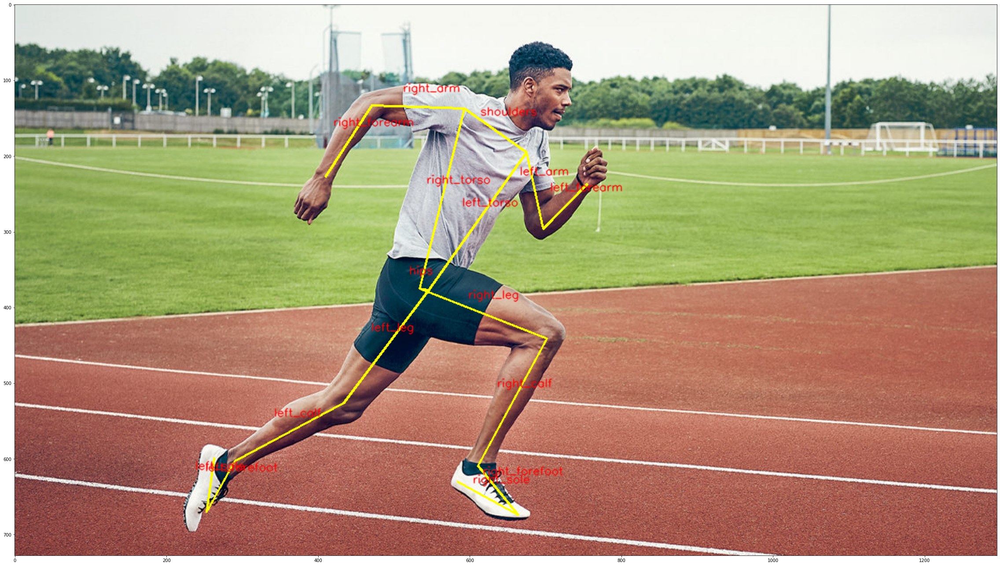

In [13]:
limbs_labelled = image.copy()
draw_limbs(limbs_labelled, limbs, colour=(255,255,0))
label_limbs(limbs_labelled, colour=(255,0,0))
fig = plt.figure(figsize=(40, 40))
plt.imshow(limbs_labelled)

In [14]:
valid_angles = ['right_arm|right_forearm', 'left_arm|left_forearm', 
                'right_calf|right_leg', 'left_calf|left_leg', 
                'right_calf|right_forefoot', 'left_calf|left_forefoot', 
                'right_arm|right_torso', 'left_arm|left_torso',
                'right_leg|right_torso', 'left_leg|left_torso']
                
def label_angles(image):
    for index, angle in enumerate(valid_angles):
        limb_0, limb_1 = angle.split("|")
        limb_0_0 = limbs[limb_0]["first_node"]
        limb_0_1 = limbs[limb_0]["second_node"]
        limb_1_0 = limbs[limb_1]["first_node"]
        limb_1_1 = limbs[limb_1]["second_node"]
        # find the common node
        if limb_0_0["id"] == limb_1_0["id"]:
            common_node = limb_0_0
        elif limb_0_0["id"] == limb_1_1["id"]:
            common_node = limb_0_0
        elif limb_0_1["id"] == limb_1_0["id"]:
            common_node = limb_0_1
        elif limb_0_1["id"] == limb_1_1["id"]:
            common_node = limb_0_1
        else:
            continue
        angle = get_angle(limb_0, limb_1)
        x = common_node["image_coords"][0]
        y = common_node["image_coords"][1]
        cv.putText(image, str(round(angle, 1)), (int(x) - 20, int(y) + 20), cv.FONT_HERSHEY_SIMPLEX, 0.5, (255,255,255), 1, cv.LINE_AA)

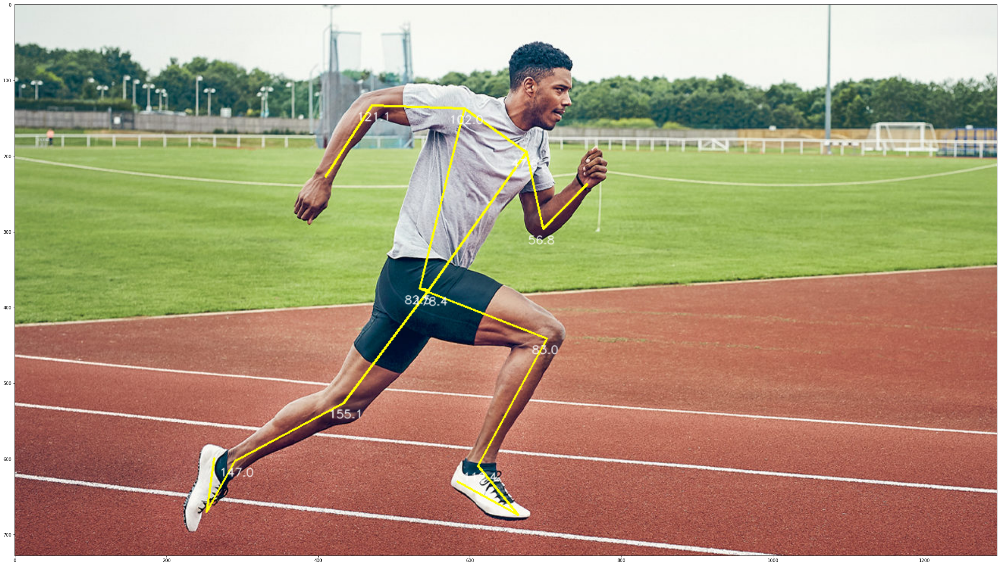

In [15]:
angle_labelled = image.copy()
draw_limbs(angle_labelled, limbs, colour=(255,255,0))
label_angles(angle_labelled)
fig = plt.figure(figsize=(40, 40))
plt.imshow(angle_labelled)

## Different Photo

Now, I will use a different photo, and see if the program can still detect the poses. I have compiled all the above methods into a class, for ease of use

In [16]:
from classes import pose_detector
jump_image = cv.imread("./inputs/jump_0.jpg")
jump_processed = pose_detector.ImageProcessor(jump_image)

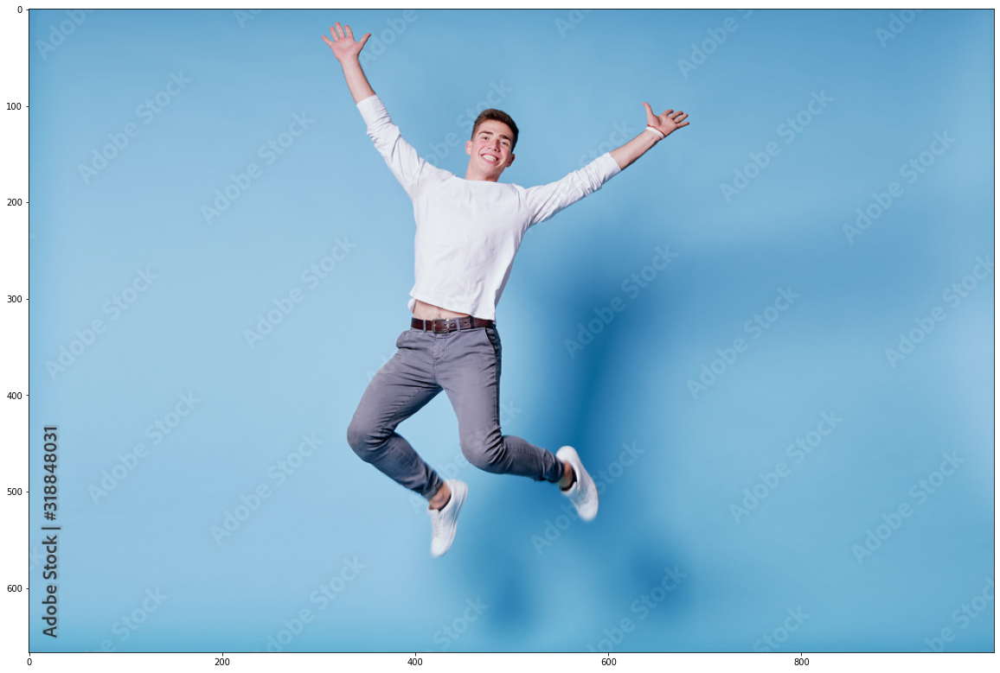

In [17]:
og = jump_processed.display()
fig = plt.figure(figsize=(20, 20))
plt.imshow(cv.cvtColor(og, cv.COLOR_BGR2RGB))

The detection still works properly as shown

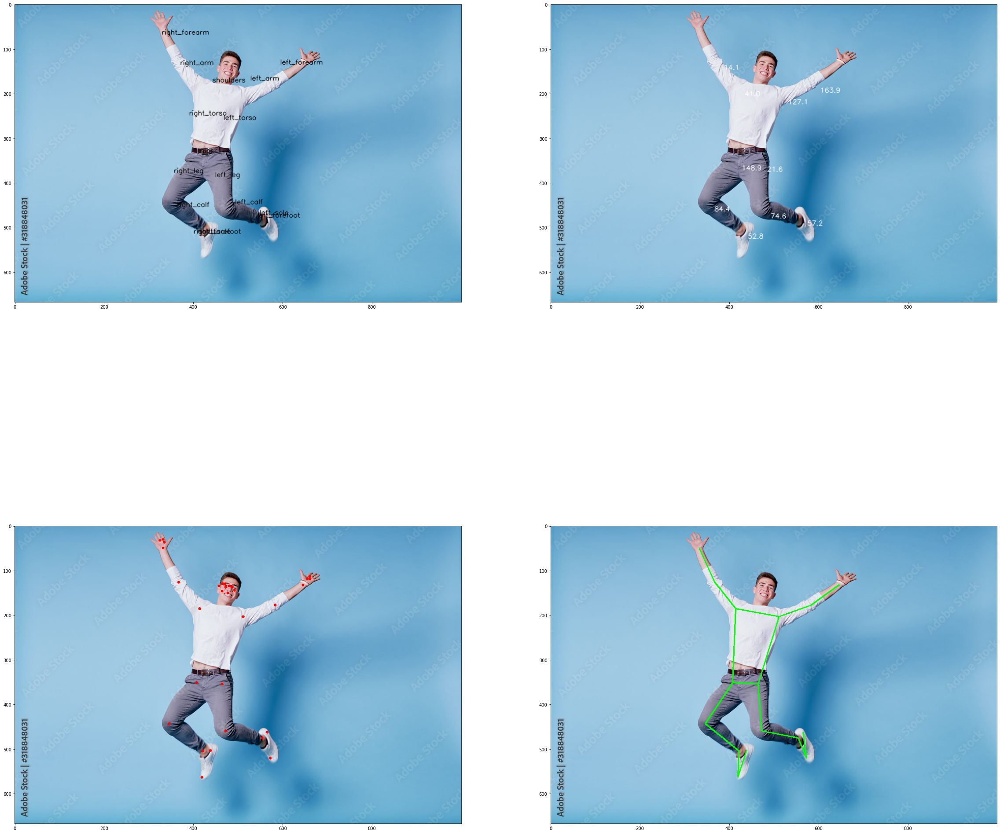

In [18]:
fig = plt.figure(figsize=(40, 40))
plt.subplot(2, 2, 1)
jump_labelled_limbs = jump_processed.display(1)
plt.imshow(cv.cvtColor(jump_labelled_limbs, cv.COLOR_BGR2RGB))
plt.subplot(2, 2, 2)
jump_labelled_angles = jump_processed.display(2)
plt.imshow(cv.cvtColor(jump_labelled_angles, cv.COLOR_BGR2RGB))
plt.subplot(2, 2, 3)
jump_landmarks = jump_processed.display(3)
plt.imshow(cv.cvtColor(jump_landmarks, cv.COLOR_BGR2RGB))
plt.subplot(2, 2, 4)
jump_limbs = jump_processed.display(4)
plt.imshow(cv.cvtColor(jump_limbs, cv.COLOR_BGR2RGB))


Now, we also can directly access every angle at once, or we can get a specific angle by specifying the limbs, regardless of the order

In [19]:
print(jump_processed.get_angles())
print(jump_processed.get_specific_angle("right_leg", "right_calf"), jump_processed.get_specific_angle("right_calf", "right_leg"))

{'right_arm|right_forearm': 14.097228840864812, 'left_arm|left_forearm': 163.88282732003614, 'right_calf|right_leg': 84.42350119055092, 'left_calf|left_leg': 74.60208481382998, 'right_calf|right_forefoot': 52.81887899755752, 'left_calf|left_forefoot': 57.157650333324455, 'right_arm|right_torso': 40.95584014213213, 'left_arm|left_torso': 127.14440035406795, 'right_leg|right_torso': 148.868547936943, 'left_leg|left_torso': 21.646160990593206}
84.42350119055092 84.42350119055092


# Video
## Initial Pose Detection

In [15]:
pose_sol = mp.solutions.pose
mp_draw = mp.solutions.drawing_utils
pose = pose_sol.Pose()
video = cv.VideoCapture("./inputs/pushup.mp4")
while True:
    success, img = video.read()
    if success:
        image_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)
        results = pose.process(image_rgb)
        mp_draw.draw_landmarks(img, results.pose_landmarks, pose_sol.POSE_CONNECTIONS)
        cv.imshow("Video", img)
        cv.waitKey(1)
    else:
        cv.destroyAllWindows()
        break

In [47]:
detected = 33 * [0]
video = cv.VideoCapture("./inputs/pushup.mp4")
results = []
images = []
while True:
    success, image = video.read()
    if success:
        image_rgb = cv.cvtColor(image, cv.COLOR_BGR2RGB)
        processing = pose.process(image_rgb)
        images.append(image_rgb)
        results.append(processing)
        if processing.pose_landmarks:
            for index, landmark in enumerate(processing.pose_landmarks.landmark):
                if landmark.visibility > 0.5:
                    detected[index] += 1
        cv.imshow("Video", image)
        cv.waitKey(1)
    else:
        cv.destroyAllWindows()
        break

In [48]:
landmark_names = ["nose", "left_eye_inner", "left_eye", "left_eye_outer", "right_eye_inner", "right_eye", "right_eye_outer", "left_ear", "right_ear", "mouth_left", "mouth_right", "left_shoulder", "right_shoulder", "left_elbow", "right_elbow", "left_wrist", "right_wrist", "left_pinky", "right_pinky", "left_index", "right_index", "left_thumb", "right_thumb", "left_hip", "right_hip", "left_knee", "right_knee", "left_ankle", "right_ankle", "left_heel", "right_heel", "left_foot_index", "right_foot_index"]
landmark_detected = {}
for index, landmark in enumerate(landmark_names):
    landmark_detected[landmark] = detected[index]

In [68]:
limb_names = {(12,14):"right_arm", (14,16):"right_forearm", (11,13):"left_arm", (13,15):"left_forearm", (23,25):"left_leg", (25,27):"left_calf", (24,26):"right_leg", 
                            (26,28):"right_calf", (29,31): "left_sole", (30,32): "right_sole", (28,32): "right_forefoot", (27,31): "left_forefoot", (11,23): "left_torso", (12,24): "right_torso",
                            (11,12): "shoulders", (23,24): "hips"}

valid_angles = ['right_arm|right_forearm', 'left_arm|left_forearm', 
                        'right_calf|right_leg', 'left_calf|left_leg', 
                        'right_calf|right_forefoot', 'left_calf|left_forefoot', 
                        'right_arm|right_torso', 'left_arm|left_torso',
                        'right_leg|right_torso', 'left_leg|left_torso']
detected_limbs = {}
result = results[0]
image = images[0]
for tuple in limb_names.keys():
    lm_0 = tuple[0]
    lm_1 = tuple[1]
    if result.pose_landmarks.landmark[lm_0].visibility > 0.5 and result.pose_landmarks.landmark[lm_1].visibility > 0.5:
        detected_limbs[limb_names[tuple]] = {"landmarks": [lm_0, lm_1], "image_coords": [result.pose_landmarks.landmark[lm_0].x, result.pose_landmarks.landmark[lm_0].y, result.pose_landmarks.landmark[lm_1].x, result.pose_landmarks.landmark[lm_1].y]}

detected_angles = []
for angle in valid_angles:
    limb_0 = angle.split("|")[0]
    limb_1 = angle.split("|")[1]
    if limb_0 in detected_limbs.keys() and limb_1 in detected_limbs.keys():
        detected_angles.append(angle)

In [70]:
detected_limbs

{'right_arm': {'landmarks': [12, 14],
  'image_coords': [0.4687832295894623,
   0.32250306010246277,
   0.40987443923950195,
   0.5920645594596863]},
 'right_forearm': {'landmarks': [14, 16],
  'image_coords': [0.40987443923950195,
   0.5920645594596863,
   0.40918412804603577,
   0.8891047239303589]},
 'left_arm': {'landmarks': [11, 13],
  'image_coords': [0.616349995136261,
   0.3837084174156189,
   0.6506422758102417,
   0.637065052986145]},
 'left_forearm': {'landmarks': [13, 15],
  'image_coords': [0.6506422758102417,
   0.637065052986145,
   0.6788736581802368,
   0.8599279522895813]},
 'right_leg': {'landmarks': [24, 26],
  'image_coords': [0.29843059182167053,
   0.5313466191291809,
   0.20255665481090546,
   0.6524165272712708]},
 'right_calf': {'landmarks': [26, 28],
  'image_coords': [0.20255665481090546,
   0.6524165272712708,
   0.09326273947954178,
   0.7149087190628052]},
 'right_sole': {'landmarks': [30, 32],
  'image_coords': [0.06926033645868301,
   0.6987975239753723

In [74]:
def calc_gradient(point_0, point_1):
        return (point_1[1] - point_0[1]) / (point_1[0] - point_0[0])

def calc_angle(limb_0, limb_1):
    limb_0 = detected_limbs[limb_0]
    limb_1 = detected_limbs[limb_1]
    limb_0_0 = limb_0["image_coords"][0:2]
    limb_0_1 = limb_0["image_coords"][2:4]
    limb_1_0 = limb_1["image_coords"][0:2]
    limb_1_1 = limb_1["image_coords"][2:4]
    gradient_0 = calc_gradient(limb_0_0, limb_0_1)
    gradient_1 = calc_gradient(limb_1_0, limb_1_1)
    angle = math.degrees(math.atan((gradient_1 - gradient_0) / (1 + (gradient_1 * gradient_0))))
    return angle

for angle in detected_angles:
    limb_0 = angle.split("|")[0]
    limb_1 = angle.split("|")[1]
    print(limb_0, limb_1, calc_angle(limb_0, limb_1))

right_arm right_forearm -12.194211608068494
left_arm left_forearm 0.48869603107871085
right_calf right_leg -21.864577961341418
right_calf right_forefoot -73.00194547803493
right_arm right_torso 26.87658703430258
left_arm left_torso 61.56851478957826
right_leg right_torso 0.8286339487750862
